<font size="6">Сжатие звуковой дорожки при помощи алгоритма PCA</font>

## 1 Исследование дорожки

In [1]:
# Понадобится для чтения и записи аудио файлов
from scipy.io import wavfile

# Это нужно для проигрывания аудио файлов прямо в блокноте
from IPython.display import Audio

# А это набор для этого задания
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA

In [2]:
# Скачаем данные
! wget https://www.dropbox.com/s/p5147nr8mzemxnr/Beethoven_Violin_Sonata_Op_96_first_movement_bars_1-22.wav

--2022-11-17 08:26:16--  https://www.dropbox.com/s/p5147nr8mzemxnr/Beethoven_Violin_Sonata_Op_96_first_movement_bars_1-22.wav
Resolving www.dropbox.com (www.dropbox.com)... 162.125.5.18, 2620:100:601d:18::a27d:512
Connecting to www.dropbox.com (www.dropbox.com)|162.125.5.18|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: /s/raw/p5147nr8mzemxnr/Beethoven_Violin_Sonata_Op_96_first_movement_bars_1-22.wav [following]
--2022-11-17 08:26:16--  https://www.dropbox.com/s/raw/p5147nr8mzemxnr/Beethoven_Violin_Sonata_Op_96_first_movement_bars_1-22.wav
Reusing existing connection to www.dropbox.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://ucf20f26eabcdfa8d9ad1974aa11.dl.dropboxusercontent.com/cd/0/inline/Bw68RJTsUYwBwLAGVpbj_RbYx08NDEyJShGGk_xK45awE_t2kDH5_34LFD6k1X0YxVM_Lty_qPqUqNpX2YGDurM6Sq5WdQuezgV9HlFvMZs2AzS5lnhv96VxXk44Gu3HmBVWfxhtmUBQu5o46bug0BAb6jpwmBNdKmDqz-A8Wj5N1g/file# [following]
--2022-11-17 08:26:17--  https://ucf20f26e

In [3]:
# Прочитаем аудио дорожку при помощи wavfile
samplerate, data = wavfile.read('Beethoven_Violin_Sonata_Op_96_first_movement_bars_1-22.wav')

In [4]:
# Посмотрим какая у нас частота диспретезации
print(samplerate)

44100


In [5]:
# Если поделить длину массива сигнала на samplerate, получится длительность аудиодорожки в секундах

print(len(data) / samplerate)

# 45 секунд - похоже на правду:)

45.139591836734695


In [6]:
# Заметим, что звук - стерео, так как сигнал кодируется двумя каналами (для левого и правого динамика):

print(data.shape)

(1990656, 2)


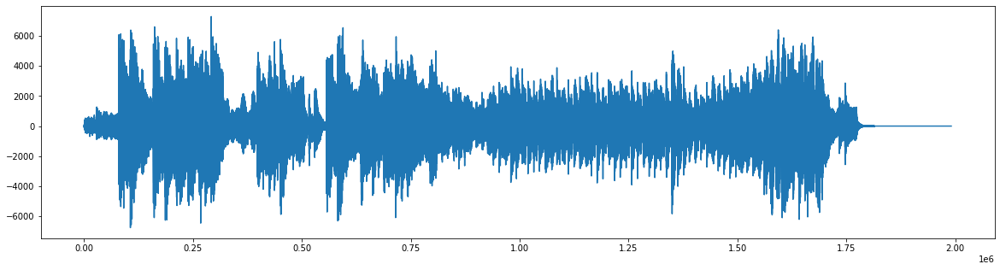

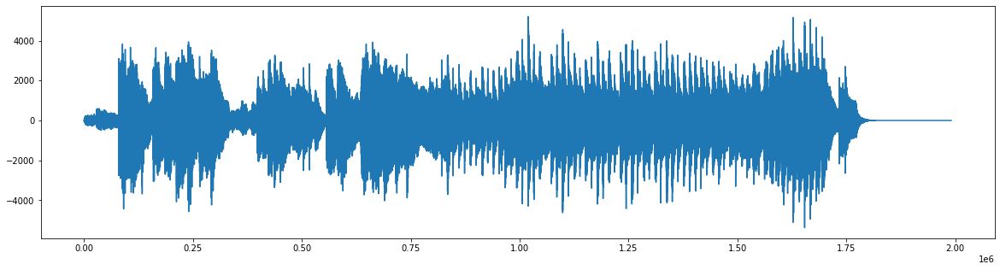

In [7]:
# Отрисуем сигналы в обоих каналах

# Канал 1
plt.figure(figsize=(20,5))
plt.plot(data[:,0])
plt.show()

# Канал 2
plt.figure(figsize=(20,5))
plt.plot(data[:,1])
plt.show()

In [8]:
# Усредним каналы, и получим моно звук, с которым будет проще работать

mono_sound = np.mean(data, axis=1)
print(mono_sound.shape)

(1990656,)


In [9]:
# Давайте послушаем, что же мы будем сжимать:)

Audio(mono_sound, rate = samplerate)

In [10]:
# Для удобства - обрежем массив с сигналом так, чтобы его было удобнее делить на равные части, датасет из которых и необходимо будет сжать

mono_sound_to_cut = mono_sound[:1990000]

In [11]:
# Проверим, что наш звук теперь это просто вектор числел

print(mono_sound_to_cut.shape)

(1990000,)


In [12]:
X = mono_sound_to_cut.reshape(-1, 1000)

In [13]:
X

array([[  0. ,  -1. ,  -1. , ...,  88.5,  58.5,  18. ],
       [-25.5, -61.5, -81.5, ...,  30.5, -20.5, -53. ],
       [-67.5, -65.5, -50. , ..., 118.5, 118.5,  86.5],
       ...,
       [  0. ,   0. ,   0. , ...,   0. ,   0. ,   0. ],
       [  0. ,   0. ,   0. , ...,   0. ,   0. ,   0. ],
       [  0. ,   0. ,   0. , ...,   0. ,   0. ,   0. ]])

In [14]:
#Функция возврата дорожки к вектору
def back(cnt):
  return cnt.reshape(-1)

In [15]:
res = back(X)

In [16]:
(res == mono_sound_to_cut).sum()

1990000

## 2 PCA

In [17]:
from sklearn.decomposition import PCA

In [18]:
# Создадим объект класса PCA с числом компонент, равным 150
pca = PCA(n_components=150)

In [19]:
# Обучим и преобразуем нашу матрицу X при помощи метода fit_transform
trans = pca.fit_transform(X)

In [20]:
trans.shape

(1990, 150)

In [21]:
pca.explained_variance_ratio_.shape

(150,)

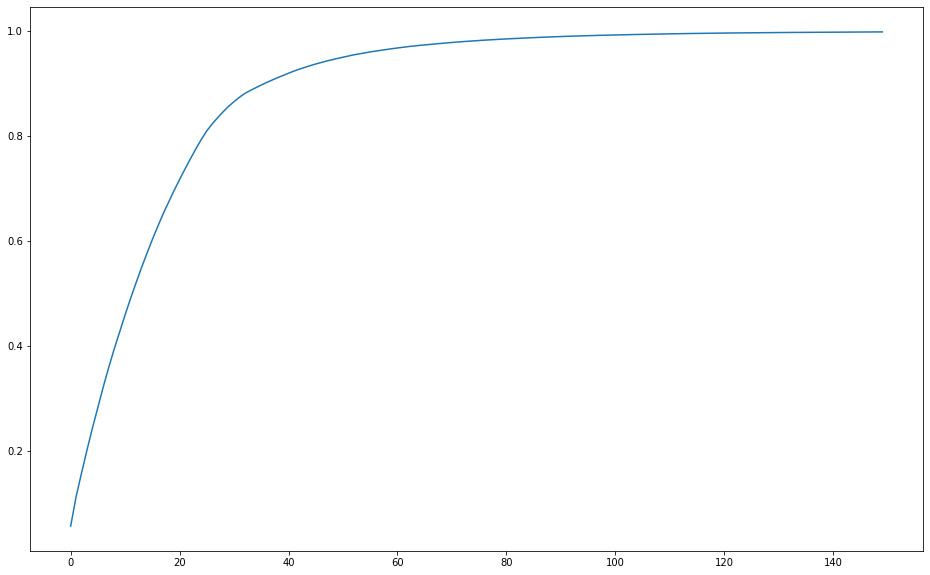

In [22]:
plt.figure(figsize=(16, 10))
plt.plot(pca.explained_variance_ratio_[:].cumsum());

In [23]:
pca.components_.shape

(150, 1000)

In [24]:
X_2D =  pca.transform(X)

In [25]:
X_2D.shape

(1990, 150)

In [26]:
pca_2 = PCA(n_components=2)

In [27]:
X_pca = pca_2.fit_transform(X)

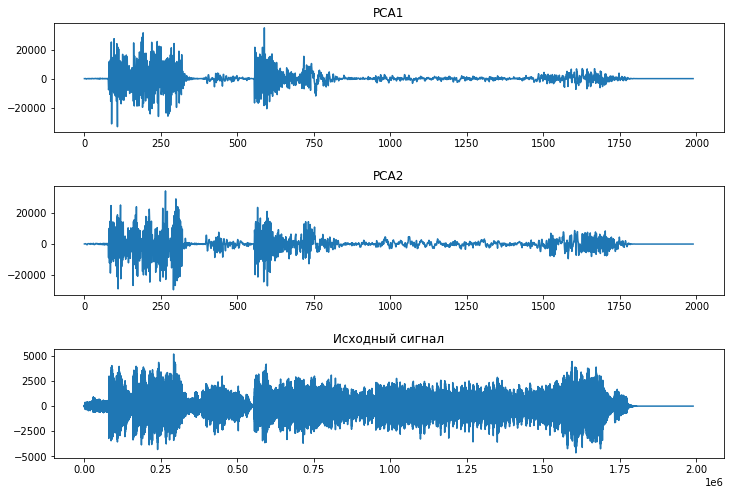

In [28]:
fig, ax = plt.subplots(3, figsize = (12,8))
ax[0].plot(X_pca[:,0])
ax[1].plot(X_pca[:,1])
ax[2].plot(mono_sound_to_cut)
ax[0].set_title('PCA1')
ax[1].set_title('PCA2')
ax[2].set_title('Исходный сигнал')
plt.subplots_adjust(hspace = 0.5)
plt.show();

Видно, что из-за недостатка информации (из-за сильного сжатия) звук пропадает, частота звука затухает

In [29]:
X_hat = pca_2.inverse_transform(X_pca)

In [30]:
print(X.shape)
print(X_pca.shape)
print(X_hat.shape)

(1990, 1000)
(1990, 2)
(1990, 1000)


In [31]:
pca.components_

array([[ 0.01610444,  0.01756474,  0.0191055 , ...,  0.01575156,
         0.01407697,  0.01248191],
       [-0.05178559, -0.05325507, -0.05467971, ...,  0.0539636 ,
         0.05216986,  0.05036858],
       [ 0.01190671,  0.01178354,  0.01158916, ...,  0.01987407,
         0.02171399,  0.02333951],
       ...,
       [ 0.01139787,  0.01547806,  0.01421361, ...,  0.01398219,
         0.00911166, -0.00421072],
       [ 0.0071647 , -0.00842377, -0.01071197, ..., -0.008419  ,
        -0.0249988 , -0.03663742],
       [-0.0101869 , -0.01140256, -0.01082198, ...,  0.00247925,
        -0.01361272, -0.02730339]])

In [32]:
print(pca_2.explained_variance_ratio_)

[0.0568204  0.05589545]


Видим, что первый компонент объясняет 5.6%, второй 5.5% из информации в датасете

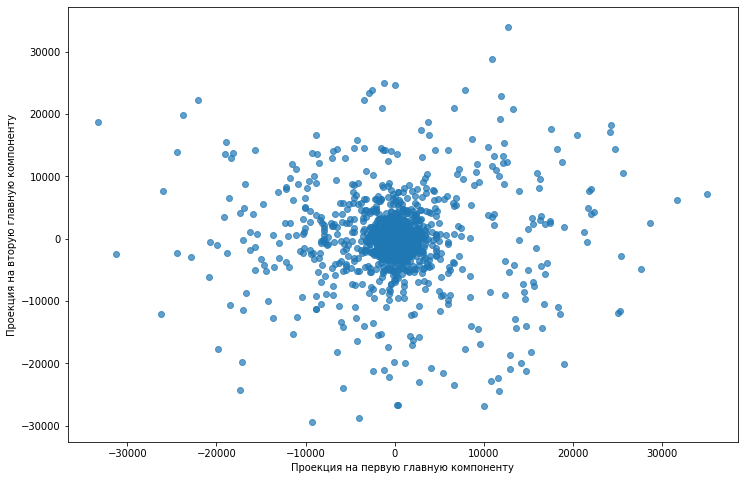

In [33]:
plt.figure(figsize=(12,8))
plt.scatter(X_pca[:, 0], X_pca[:, 1],  alpha=0.7)

plt.xlabel('Проекция на первую главную компоненту')
plt.ylabel('Проекция на вторую главную компоненту');


Эти компоненты означают: полные данные - это 1000-мерное облако точек, и эти точки - проекция каждой точки данных вдоль направлений с наибольшей дисперсией. По существу, мы нашли оптимальное растяжение и вращение в 1000-мерном пространстве, которое позволяет видеть расположение цифр в двух измерениях, и сделали это без контроля, то есть без привязки к меткам.

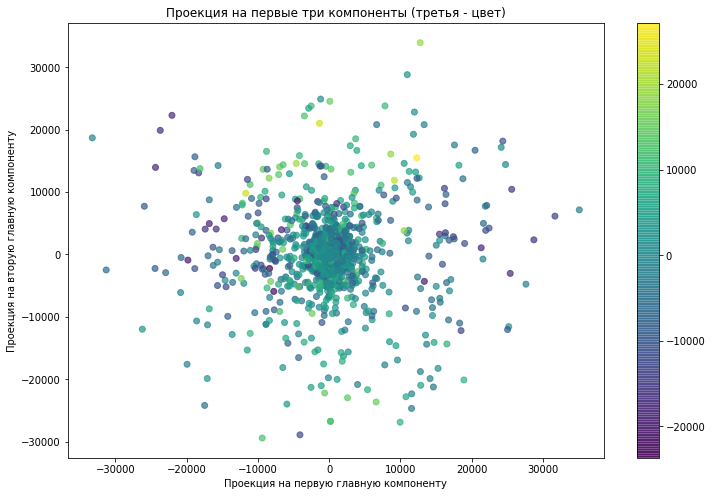

In [34]:
pca_3 = PCA(n_components=3)
X_pca_3 = pca_3.fit_transform(X)
plt.figure(figsize=(12, 8))
plt.scatter(X_pca_3[:,0], X_pca_3[:,1], c=X_pca_3[:,2], alpha=0.7)
plt.xlabel('Проекция на первую главную компоненту')
plt.ylabel('Проекция на вторую главную компоненту')
plt.title('Проекция на первые три компоненты (третья - цвет)')
plt.colorbar()
plt.show()

Мы видим наложение графиков первой и второй компоненты друг на друга. Почти все элементы выборки находятся примерно на одинаковом расстоянии друг от друга

In [35]:
from mpl_toolkits.mplot3d import Axes3D

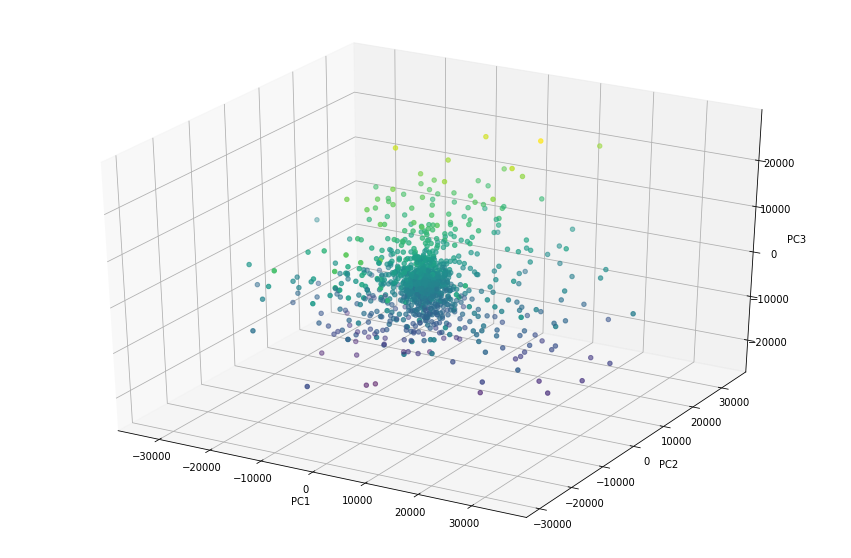

In [36]:
fig = plt.figure(figsize = (15,10))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(X_pca_3[:,0], X_pca_3[:,1], X_pca_3[:,2],c=X_pca_3[:,2])
ax.set_xlabel('PC1')
ax.set_ylabel('PC2')
ax.set_zlabel('PC3');

In [37]:

X_rev = pca.inverse_transform(trans)

In [38]:
X_rev.shape

(1990, 1000)

In [39]:
updt = back(X_rev)

In [40]:
updt.shape

(1990000,)

In [41]:
Audio(updt, rate = samplerate)

## 3 Исследование силы сжатия

In [42]:
from scipy.ndimage import gaussian_filter1d

In [43]:
def test(sound, cnt_pca, col):
  X = sound.reshape(-1, col)
  pca = PCA(n_components=cnt_pca)
  pca_gr = PCA(n_components=cnt_pca+50)
  pca_gr.fit_transform(X)
  trans = pca.fit_transform(X)
  graphic = pca_gr.explained_variance_ratio_[:].cumsum()
  plt.figure(figsize=(12, 8))
  plt.plot(graphic)
  ax = plt.plot(cnt_pca, graphic[cnt_pca], 'o', color='black')
  plt.text(cnt_pca-10, graphic[cnt_pca], '(%d, %.3f)' % (cnt_pca, graphic[cnt_pca]))
  plt.xlabel('Количество компонент', fontsize =16)
  plt.ylabel('Процент описанных данных', fontsize =16);
  X_rev = pca.inverse_transform(trans)
  back_sgl = X_rev.reshape(len(X)*col)
  return Audio(gaussian_filter1d(back_sgl, 2), rate = samplerate), Audio(back_sgl, rate = samplerate)

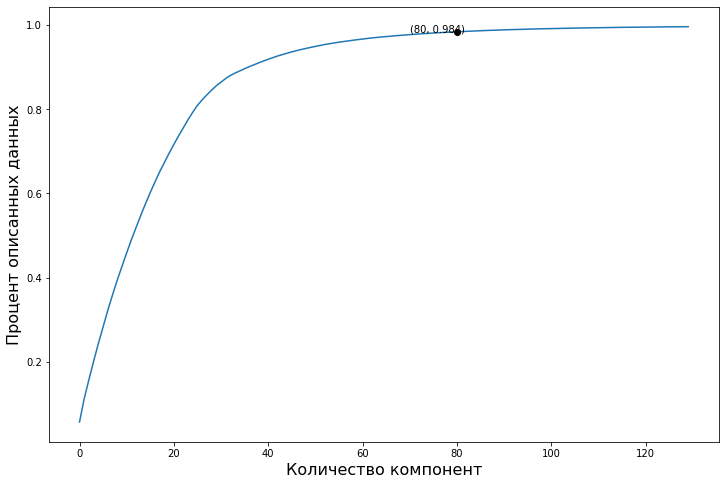

In [44]:
filtered, nofiltered = test(mono_sound_to_cut, 80, 1000)

In [45]:
filtered

In [46]:
nofiltered

Фильтрация помогла, ушёл сильный треск, шум

Количество компонент, которое вы выбрали это много или мало?
Как сильно можно сжать звук таким образом?
А если нам дадут другую звуковую дорожку, нам надо сделать то же самое, чтобы сжать звук, как автоматически подобрать число компонент и возможно ли это?

- Можно выбрать меньше компонент, но менее 30 уже сильно страдает качество звука, менее 60 появляются шумы.  Сила сжатия звука зависит от количества компонент и количества частей, на которые будем делить сигнал. Найти оптимальное число компонент можно только по графику (пример графика выше). Выбираем количество компонент по графику, которое близко к 100%(1) по оси процента описанных данных.
- Сила сжатия зависит от количества компонент и количества частей, на которые будем делить сигнал линейно, т.к. сила сжатия это - соотношения размера частей, на которые делится сигнал к размеру пространсва, в которое вы сжимали данные с помощью PCA

In [ ]:
# Функция сжатия звука
def fnl(sound, cnt_pca, col):
  X = sound.reshape(-1, col)
  pca = PCA(n_components=cnt_pca)
  trans = pca.fit_transform(X)
  plt.figure(figsize=(10, 6))
  plt.plot(pca.explained_variance_ratio_[:].cumsum());
  X_rev = pca.inverse_transform(trans)
  back_sgl = X_rev.reshape(len(X)*col)
  return Audio(gaussian_filter1d(back_sgl, 2), rate = samplerate), Audio(back_sgl, rate = samplerate)#, back_sgl, trans,

соотношения размера частей, на которые делился сигнал в задании 1.1 к размеру пространсва, в которое вы сжимали данные с помощью PCA равно col/cnt_pca, где col - количество отрезков, на которые делим сигнал, cnt_pca - количество компонент. Чем выше степень сжатия, тем хуже звук, при степени сжатия с 400 потеря качества при гауссе и с 250 без гаусса, при количестве компонент 40. При соотношении 1 к 10 звук без гаусса ухудшается, при соотношении 4 к 25 звук с гауссом ухудшается. Это так работает, т.к. чем меньше соотношение размера частей, на которые делился сигнал в задании 1.1 к размеру пространсва, в которое мы сжимали данные с помощью PCA, тем меньше информации в данных

Исследование для компонент = 40

In [ ]:
#Первая 40- Количество компонент, вторая 40 - степень сжатия, 
filtered_40, no_filtered_40 = fnl(mono_sound_to_cut, 40, 40)

In [ ]:
filtered_40

In [ ]:
no_filtered_40

In [ ]:
filtered_100, no_filtered_100 = fnl(mono_sound_to_cut, 40, 100)


In [ ]:
filtered_100

In [ ]:
no_filtered_100

In [ ]:
filtered_199, no_filtered_199 = fnl(mono_sound_to_cut, 40, 199)

In [ ]:
no_filtered_199

In [ ]:
no_filtered_199

In [ ]:
filtered_250, no_filtered_250 = fnl(mono_sound_to_cut, 40, 250)

In [ ]:
filtered_250

In [ ]:
no_filtered_250

In [ ]:
filtered_400, no_filtered_400 = fnl(mono_sound_to_cut, 40, 400)


In [ ]:
filtered_400

In [ ]:
no_filtered_400

In [ ]:
filtered_1000, no_filtered_1000 = fnl(mono_sound_to_cut, 40, 1000)

In [ ]:
filtered_1000

In [ ]:
no_filtered_1000

In [ ]:
filtered_1250, no_filtered_1250 = fnl(mono_sound_to_cut, 125, 1250)

In [ ]:
filtered_1250

In [ ]:
no_filtered_1250

По графикам видим, что при постоянном значении компонент при увелечении степени сжатия, компоненты определяют меньше информации

Степень сжатия можно подобрать, она должна быть кратна длине сигнала. В нашей задаче степень сжатия отвечает за количество отрезков, на которые мы разбиваем звук. Чем выше степень сжатия при одинаковом количестве компонент, тем хуже звук. Это так работает, т.к. чем меньше соотношение размера частей, на которые делился сигнал в задании 1.1 к размеру пространсва, в которое мы сжимали данные с помощью PCA, тем меньше информации в данных. Можно указать PCA(n), где n (0;1) - количество информации в %, которые мы хотим сохранить после РСА.

Степень сжатия задаёт количество измерений сигнала. Для РСА это значит, какое количество измерений оно будет уменьшать. Чем больше степень сжатия, тем больше нужно компонент РСА, чтобы сохранить оптимальное количество информации. Степень сжатия не может быть меньше количества компонент. С помощью алгоритма PCA мы находим признаки-комбинации и, ценой части информации, выражаем эти признаки меньшим количеством признаков. Т.к. длина вектора аудиозаписи в 3 мин больше, чем в задании, то мы хотим разбить на меньшее количество отрезков, потому что при постоянном значении РСА увелечиния количества разбиений на отрезки уменьшает количество информации

Исследуем дорожку большего размера

In [ ]:
!wget https://filesamples.com/samples/audio/wav/sample2.wav

In [ ]:
samplerate_1, data_1 = wavfile.read('sample2.wav')

In [ ]:
# Посмотрим какая у нас частота диспретезации
print(samplerate_1)

In [ ]:
#Смотрим длину дорожки
print(len(data_1) / samplerate_1)

In [ ]:
#Звук-стерео
print(data_1.shape)

In [ ]:
# Усредним каналы, и получим моно звук, с которым будет проще работать
mono_sound_1 = np.mean(data_1, axis=1)
print(mono_sound_1.shape)

In [ ]:
mono_sound_to_cut_1 = mono_sound_1[:9585000]

In [ ]:
test_1, no_test_1 = fnl(mono_sound_to_cut_1, 60, 100)

In [ ]:
test_1

In [ ]:
no_test_1

In [ ]:
test_2, no_test_2 = fnl(mono_sound_to_cut_1, 60, 1000)

In [ ]:
test_2

In [ ]:
no_test_2

In [ ]:
test_3, no_test_3 = fnl(mono_sound_to_cut_1, 60, 15000)

In [ ]:
test_3

In [ ]:
no_test_3

In [ ]:
test_4, no_test_4 = fnl(mono_sound_to_cut_1, 150, 15000)

In [ ]:
test_4

In [ ]:
no_test_4

Видим, что при разбиении на 15000 отрезков при количестве 60 компонент мы захватываем около 90% информации, при количестве компонент 150 95-97%

Вывод:
Количество компонент зависит от степени сжатия: чем выше степень сжатия, тем больше нужно компонент, чтобы иметь валидное количество информации